<a href="https://colab.research.google.com/github/Acesarsilva/Smartphone_Web_Crawler/blob/main/Classificao_de_paginas.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#!git clone https://github.com/Acesarsilva/Smartphone_Web_Crawler

In [183]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [184]:
import matplotlib.pyplot as plt
from bs4 import BeautifulSoup
import pandas as pd
from lxml import html

In [191]:
list_html = []
inputs = {'/content/drive/MyDrive/Colab Notebooks/RI/files/html_1.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_2.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_3.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_4.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_6.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_7.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_8.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_9.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_10.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_11.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_12.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_13.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_14.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_15.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_16.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_17.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_18.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_19.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_20.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_21.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_22.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_23.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_24.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_25.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_26.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_43.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_44.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_45.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_46.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_47.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_48.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_49.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_60.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_62.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_63.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_64.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_65.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_66.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_67.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_68.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_69.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_70.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_71.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_72.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_73.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_74.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_75.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_76.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_77.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_78.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_79.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_81.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_82.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_83.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_84.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_85.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_86.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_87.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_88.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_89.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_90.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_91.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_92.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_94.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_95.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_96.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_97.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_98.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_99.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_100.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_101.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_102.html':1,
#'/content/drive/MyDrive/Colab Notebooks/RI/files/html_103.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_104.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_105.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_106.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_108.html':1,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_110.html':0,
#'/content/drive/MyDrive/Colab Notebooks/RI/files/html_111.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_112.html':0,
#'/content/drive/MyDrive/Colab Notebooks/RI/files/html_113.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_114.html':0,
'/content/drive/MyDrive/Colab Notebooks/RI/files/html_115.html':0}

for path in inputs.keys():
  f1 = open(path, encoding="utf8")     
  soup1 = BeautifulSoup(f1,'lxml')
  list_html.append(soup1.text)
  f1.close()

In [192]:
list_html

['\nvar aPageStart = (new Date()).getTime();\n\n\n\n\n\n\n\n\n\n\n(function(d,f,Q,D){function E(a){u&&u.tag&&u.tag(p(":","aui",a))}function r(a,b){u&&u.count&&u.count("aui:"+a,0===b?0:b||(u.count("aui:"+a)||0)+1)}function n(a){try{return a.test(navigator.userAgent)}catch(b){return!1}}function x(a,b,c){a.addEventListener?a.addEventListener(b,c,!1):a.attachEvent&&a.attachEvent("on"+b,c)}function p(a,b,c,h){b=b&&c?b+a+c:b||c;return h?p(a,b,h):b}function F(a,b,c){try{Object.defineProperty(a,b,{value:c,writable:!1})}catch(h){a[b]=c}return c}function wa(a,b,c){var h=\nc=a.length,d=function(){h--||(R.push(b),S||(setTimeout(ea,0),S=!0))};for(d();c--;)fa[a[c]]?d():(y[a[c]]=y[a[c]]||[]).push(d)}function xa(a,b,c,h,d){var e=f.createElement(a?"script":"link");x(e,"error",h);d&&x(e,"load",d);a?(e.type="text/javascript",e.async=!0,c&&/AUIClients|images[/]I/.test(b)&&e.setAttribute("crossorigin","anonymous"),e.src=b):(e.rel="stylesheet",e.href=b);f.getElementsByTagName("head")[0].appendChild(e)}funct

In [193]:
print(list_html[6])


var aPageStart = (new Date()).getTime();










(function(d,f,Q,D){function E(a){u&&u.tag&&u.tag(p(":","aui",a))}function r(a,b){u&&u.count&&u.count("aui:"+a,0===b?0:b||(u.count("aui:"+a)||0)+1)}function n(a){try{return a.test(navigator.userAgent)}catch(b){return!1}}function x(a,b,c){a.addEventListener?a.addEventListener(b,c,!1):a.attachEvent&&a.attachEvent("on"+b,c)}function p(a,b,c,h){b=b&&c?b+a+c:b||c;return h?p(a,b,h):b}function F(a,b,c){try{Object.defineProperty(a,b,{value:c,writable:!1})}catch(h){a[b]=c}return c}function wa(a,b,c){var h=
c=a.length,d=function(){h--||(R.push(b),S||(setTimeout(ea,0),S=!0))};for(d();c--;)fa[a[c]]?d():(y[a[c]]=y[a[c]]||[]).push(d)}function xa(a,b,c,h,d){var e=f.createElement(a?"script":"link");x(e,"error",h);d&&x(e,"load",d);a?(e.type="text/javascript",e.async=!0,c&&/AUIClients|images[/]I/.test(b)&&e.setAttribute("crossorigin","anonymous"),e.src=b):(e.rel="stylesheet",e.href=b);f.getElementsByTagName("head")[0].appendChild(e)}function ha(a,b){ret

#Processamento de texto e Bag Of Words

In [194]:
import unicodedata
import string
import nltk
import pandas as pd
import tensorflow as tf
pd.set_option('display.max_columns', None)
from sklearn.feature_extraction.text import CountVectorizer

In [195]:
def remove_accents(txt):
  nfkd_form = ' '.join(unicodedata.normalize('NFKD', txt).lower().replace('_',' ').replace('!',' ').replace('<',' ').replace('>',' ').replace("'"," ").replace('/',' ').replace('|',' ').replace('?',' ').replace('"',' ').replace('=',' ').replace(';',' ').replace(':',' ').replace('+',' ').replace('-',' ').replace('-',' ').replace('.',' ').replace(',',' ').replace('@',' ').replace('#',' ').replace('$',' ').replace('%',' ').replace('&',' ').replace('*',' ').replace('(',' ').replace(')',' ').replace('[',' ').replace(']',' ').replace('{',' '). replace('}',' ').split()) 
  only_ascii = nfkd_form.encode('ASCII', 'ignore').decode('ascii')
  return only_ascii

nltk.download('stopwords')
stopwords_br = nltk.corpus.stopwords.words('portuguese')
stopwords_en = nltk.corpus.stopwords.words('english')

def remove_stopword(text):
  txt_backup = " ".join([word for word in str(text).split() if (word not in stopwords_br and len(word) >= 3)])
  return " ".join([word for word in str(txt_backup).split() if (word not in stopwords_en and len(word) >= 3)])

def remove_numeric(text):
  return " ".join([word for word in str(text).split() if (word.isalpha())])

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [196]:
#Pre processamento
list_html_processor = []
for txt in list_html:
  txt = remove_accents(txt)
  txt = remove_stopword(txt)
  txt = remove_numeric(txt)
  list_html_processor.append(txt)

text_bow = CountVectorizer()
                           
#Fazendo as transformações nos arquivos HTML escolhidos
data = text_bow.fit_transform(list_html_processor)
 
#Dataframea
df_bow = pd.DataFrame(data.toarray(),columns=text_bow.get_feature_names())
df_bow.head(20)

,aaa,aaaa,aaaaaa,aac,aacute,aad,aaqme,aas,aazl,abaixaram,abaixo,abaixochina,abajures,abas,abd,abdomen,abelement,aber,aberracao,aberta,abertas,abertos,abertura,abf,abincounterenabled,able,abletopersist,abomqg,abonos,aboutproductclicktracking,abovenavinjection,abovethefold,abr,abra,abrangem,abrangente,abrate,abre,abril,abrir,abs,abschneiden,absent,absolute,absorcao,absurda,abtest,abuso,acaba,acabamento,acabamentocozinha,acabar,acabei,academicas,academicasassessoria,acampamento,acao,acaodesenhos,acaopecas,acarretara,acasin,acbadge,acc,accelerometer,accelerometercamera,accensione,accept,acceptpolicy,access,accessibility,accessibilitytext,accessible,accessibleclass,accessiblity,accessorie,accessories,accessoriesjs,accessoriestodas,accessorylabel,accessoryupsellaccordion,accessoryupsellamabot,accessoryupsellamabotaccordion,accessoryupsellbtf,accesstage,accordion,accordionrow,account,accountdata,accountfirstname,accountflyout,accountgender,accountisgoldplussupplier,accountispaidmember,accountlastname,accountlist,accountlistcontent,accountlistflyoutredesign,accountportraitimage,accounttext,accurate,acdaddtocartbutton,acdordersummary,acdspinnner,acdvalidationerrors,aceita,aceitacao,aceitamos,aceitas,aceitavel,aceitos,acelera,acelerado,acelerador,acelerometro,acenabled,acer,acessar,acesse,acessibilidade,acessiveis,acessivel,acesso,acessorio,acessorios,acessoriosbeleza,acessorioscameras,acessorioscelulares,acessorioscomprar,acessoriosequipamentos,acessoriosvideogames,achando,achar,acharam,achei,achou,acidentais,acidentalinstitucionalsobre,acidentes,acima,acionado,acionamento,acionamentoequipamentos,acionando,acione,acirc,acjsus,aco,acoes,acolchoado,acompanha,acompanhados,acompanhamento,acompanhar,acompanhe,aconchegante,acorde,acordo,acostumada,acq,acquisition,acre,acredita,acreditei,acredito,acres,acrescentado,acrlink,acrlinkclickcount,acrstarslink,acrstarslinkwithpopoverclickcount,acsux,act,action,actionbuttons,actionid,actionkind,actionkinds,actionpanel,actions,actiontype,activate,activated,activation,active,activethemeid,activetime,activexobject,activity,activityseller,activityselllimittext,actn,actpanel,actual,actually,acustica,adadad,adaptador,adaptados,adaptar,adaptavel,adapter,adaptive,adaptivesync,adaptor,adata,adchoicenorton,add,addcart,addcartsuccess,addclass,added,addedtocart,addeventlistener,addfield,addglobalhanlder,addimagelistener,addimport,additem,additional,additionalimages,additionalinfo,additionalprice,additionalpricebubblehelp,addlinkconfig,addlistener,addlogical,addlongpoletag,addmaginteracted,addmanifest,addonaddplan,addonbtn,addondesc,addondescdetails,addonitem,addonmessage,addonno,addonnothx,addontr,addonwidgets,addonwrty,addonyes,addos,addpanel,addpl,addprecheckloginlistener,addpulsarevent,address,addressbooklang,addresses,addressid,addresslang,addresslocality,addrule,addscript,addstyle,addstyles,addtocart,addtocartbuttonname,addtocartroverurl,addtoebaycenterbtn,addtolistvi,addtoqueue,addtoregistry,addtowatchlink,addtowatchurl,addtowishlist,addtowishlistaccordion,addvehicleinspectionrtm,addxoquantityparam,addyesno,adec,ademas,adequada,adequado,adesao,adeus,adiciona,adicionado,adicionados,adicionais,adicional,adicionalera,adicionando,adicionar,adicione,adids,adjhq,adjustment,adjusttableitemwidth,administradora,adminview,admitad,admitir,admito,adnactions,adnclr,adndesc,adndesclbl,adndesctbl,adnimg,adninc,adnlabel,adnlogoimg,adnlrnmore,adntitle,ado,adoble,adora,adorei,adpage,adpt,adquiridos,adquiriu,adreno,ads,adsatftracking,adservice,adsmanager,adsmap,adsorption,adspbpids,adspbtype,adstracking,adtest,aduana,aduaneiros,adulto,adunit,adunitid,adv,advanced,advel,advertencias,adxvoice,aereo,aereoalibaba,aerospace,aeu,afc,afeganistao,afetar,affiliate,affiliated,afiliada,afiliadas,afiliados,afinal,afirma,afirmacao,afirmar,afirmo,afph,africa,africana,afrikaans,afterload,aftersale,aftersaleballoontitle,aftersalseballoontext,aftershow,afuz,age,agent,aggregated,aggregatedreviewdisplay,aggregaterating,agil,agilidade,agin,agm,

In [198]:
print('Number Rows: ',len(df_bow.rows))
print('Number Columns: ',len(df_bow.columns))

Number Rows:  80
Number Columns:  16904


In [199]:
df_bow[['smartphone']]

,smartphone
0,6
1,32
2,11
3,6
4,0
...,...
75,4
76,1
77,1
78,6


In [200]:
df_bow['coluna_alvo'] = [row for row in inputs.values()]
df_bow.head(20)

,aaa,aaaa,aaaaaa,aac,aacute,aad,aaqme,aas,aazl,abaixaram,abaixo,abaixochina,abajures,abas,abd,abdomen,abelement,aber,aberracao,aberta,abertas,abertos,abertura,abf,abincounterenabled,able,abletopersist,abomqg,abonos,aboutproductclicktracking,abovenavinjection,abovethefold,abr,abra,abrangem,abrangente,abrate,abre,abril,abrir,abs,abschneiden,absent,absolute,absorcao,absurda,abtest,abuso,acaba,acabamento,acabamentocozinha,acabar,acabei,academicas,academicasassessoria,acampamento,acao,acaodesenhos,acaopecas,acarretara,acasin,acbadge,acc,accelerometer,accelerometercamera,accensione,accept,acceptpolicy,access,accessibility,accessibilitytext,accessible,accessibleclass,accessiblity,accessorie,accessories,accessoriesjs,accessoriestodas,accessorylabel,accessoryupsellaccordion,accessoryupsellamabot,accessoryupsellamabotaccordion,accessoryupsellbtf,accesstage,accordion,accordionrow,account,accountdata,accountfirstname,accountflyout,accountgender,accountisgoldplussupplier,accountispaidmember,accountlastname,accountlist,accountlistcontent,accountlistflyoutredesign,accountportraitimage,accounttext,accurate,acdaddtocartbutton,acdordersummary,acdspinnner,acdvalidationerrors,aceita,aceitacao,aceitamos,aceitas,aceitavel,aceitos,acelera,acelerado,acelerador,acelerometro,acenabled,acer,acessar,acesse,acessibilidade,acessiveis,acessivel,acesso,acessorio,acessorios,acessoriosbeleza,acessorioscameras,acessorioscelulares,acessorioscomprar,acessoriosequipamentos,acessoriosvideogames,achando,achar,acharam,achei,achou,acidentais,acidentalinstitucionalsobre,acidentes,acima,acionado,acionamento,acionamentoequipamentos,acionando,acione,acirc,acjsus,aco,acoes,acolchoado,acompanha,acompanhados,acompanhamento,acompanhar,acompanhe,aconchegante,acorde,acordo,acostumada,acq,acquisition,acre,acredita,acreditei,acredito,acres,acrescentado,acrlink,acrlinkclickcount,acrstarslink,acrstarslinkwithpopoverclickcount,acsux,act,action,actionbuttons,actionid,actionkind,actionkinds,actionpanel,actions,actiontype,activate,activated,activation,active,activethemeid,activetime,activexobject,activity,activityseller,activityselllimittext,actn,actpanel,actual,actually,acustica,adadad,adaptador,adaptados,adaptar,adaptavel,adapter,adaptive,adaptivesync,adaptor,adata,adchoicenorton,add,addcart,addcartsuccess,addclass,added,addedtocart,addeventlistener,addfield,addglobalhanlder,addimagelistener,addimport,additem,additional,additionalimages,additionalinfo,additionalprice,additionalpricebubblehelp,addlinkconfig,addlistener,addlogical,addlongpoletag,addmaginteracted,addmanifest,addonaddplan,addonbtn,addondesc,addondescdetails,addonitem,addonmessage,addonno,addonnothx,addontr,addonwidgets,addonwrty,addonyes,addos,addpanel,addpl,addprecheckloginlistener,addpulsarevent,address,addressbooklang,addresses,addressid,addresslang,addresslocality,addrule,addscript,addstyle,addstyles,addtocart,addtocartbuttonname,addtocartroverurl,addtoebaycenterbtn,addtolistvi,addtoqueue,addtoregistry,addtowatchlink,addtowatchurl,addtowishlist,addtowishlistaccordion,addvehicleinspectionrtm,addxoquantityparam,addyesno,adec,ademas,adequada,adequado,adesao,adeus,adiciona,adicionado,adicionados,adicionais,adicional,adicionalera,adicionando,adicionar,adicione,adids,adjhq,adjustment,adjusttableitemwidth,administradora,adminview,admitad,admitir,admito,adnactions,adnclr,adndesc,adndesclbl,adndesctbl,adnimg,adninc,adnlabel,adnlogoimg,adnlrnmore,adntitle,ado,adoble,adora,adorei,adpage,adpt,adquiridos,adquiriu,adreno,ads,adsatftracking,adservice,adsmanager,adsmap,adsorption,adspbpids,adspbtype,adstracking,adtest,aduana,aduaneiros,adulto,adunit,adunitid,adv,advanced,advel,advertencias,adxvoice,aereo,aereoalibaba,aerospace,aeu,afc,afeganistao,afetar,affiliate,affiliated,afiliada,afiliadas,afiliados,afinal,afirma,afirmacao,afirmar,afirmo,afph,africa,africana,afrikaans,afterload,aftersale,aftersaleballoontitle,aftersalseballoontext,aftershow,afuz,age,agent,aggregated,aggregatedreviewdisplay,aggregaterating,agil,agilidade,agin,agm,

In [201]:
df_bow[['smartphone','coluna_alvo']]

,smartphone,coluna_alvo
0,6,0
1,32,1
2,11,1
3,6,1
4,0,0
...,...,...
75,4,1
76,1,0
77,1,0
78,6,0


# Etapa 2: Feature Selection

In [202]:
from sklearn.ensemble import RandomForestClassifier
model_random_forest = RandomForestClassifier(n_estimators=10)

In [203]:
model_random_forest.fit(df_bow.drop(['coluna_alvo'],axis=1), df_bow['coluna_alvo'])

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=10,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [26]:
print(model_random_forest.feature_importances_)

[0. 0. 0. ... 0. 0. 0.]


In [284]:
dictA = dict(zip(df_bow.drop(['coluna_alvo'],axis=1), model_random_forest.feature_importances_))

In [285]:
for d in df_bow.drop(['coluna_alvo'],axis=1):
  if(dictA[d] < 0.005):
    del dictA[d]
  else:
    print(d,dictA[d])

abaixochina 0.008262910798122068
aceitacao 0.0074853801169590655
acionado 0.01518847475353207
alto 0.010287272072628138
amei 0.011048344718864947
amoled 0.012001084521312284
armazenamento 0.06896931505316511
assemblymontagem 0.006060606060606064
atftimer 0.005332921842450426
bdbb 0.007905366621258998
bddc 0.02381474344083481
bindevents 0.01618005046390251
bluetooth 0.026615899694747095
bold 0.012881854987118154
calc 0.008790330636300072
camera 0.029770647141165073
catalao 0.02144678680720845
characters 0.009503952446335442
clientwidth 0.01661661179435626
companyabilitytags 0.012275938576516607
conector 0.01591358980979429
createelement 0.01718515871501143
cursor 0.01180403641942105
desbloqueio 0.011525974685189176
energia 0.009525669537387633
entrega 0.009342787344336535
expand 0.005227173845484493
fdd 0.011377263381891536
fmtrii 0.005071894531917079
footer 0.008763693270735525
gratis 0.015137307860872725
imageid 0.008322560787934757
initcomplete 0.014486921529175053
isblackfriday 0.00

In [206]:
df_bow[dictA.keys()].head(5)

,abaixochina,aceitacao,acionado,alto,amei,amoled,android,ano,aperture,appliances,armazena,armazenamento,assemblymontagem,atendimento,atftimer,auto,bahasa,bdbb,bddc,beopow,bindevents,bluetooth,bold,boxchina,calc,camera,catalao,center,characters,clientwidth,clizbv,companyabilitytags,conector,createelement,cursor,delivery,desbloqueio,desk,energia,entrega,expand,fdd,file,fmtrii,footer,gratis,hdn,hgbpvp,hohwyw,hpbqvp,imageid,inches,initcomplete,isblackfriday,jpg,junho,jurosreceba,letao,lituano,manual,memory,mera,metro,midia,mostrador,multilaser,mundo,nfc,notas,notificacoes,offerstockavailable,padrao,pais,pessoa,pixels,polones,preimg,push,radius,recognition,responsestart,retail,robo,sale,satelitetelefone,schema,searchreturnnum,similar,smartphone,smartphones,subtree,tecnologia,touch,ultimas,url,utilizando,value,version,vestivel,virtude,wcdma,zelandia
0,0,0,0,0,0,0,4,1,0,1,0,0,0,1,0,14,0,0,0,0,0,2,4,0,0,15,0,6,0,3,0,0,0,12,4,0,0,3,1,1,0,0,0,0,5,3,0,0,0,0,0,0,0,0,161,0,0,0,0,0,0,0,0,0,0,7,0,0,0,0,0,0,0,0,0,0,0,50,4,0,3,1,0,1,0,0,0,0,6,0,0,0,4,0,27,0,1,0,0,0,0,0
1,0,0,0,0,0,0,7,0,0,1,0,0,0,1,0,224,0,0,0,0,2,5,12,0,0,11,0,50,0,4,0,0,0,12,11,1,0,0,0,1,0,0,0,0,1,2,0,0,0,0,0,0,0,0,4,0,11,0,0,0,0,0,2,0,0,1,0,2,0,0,0,0,0,0,0,0,0,34,16,0,3,0,0,0,0,0,0,0,32,4,13,1,2,0,51,0,28,4,0,0,0,0
2,0,0,0,0,0,1,4,1,1,1,0,4,0,4,0,41,0,0,0,0,2,0,6,0,0,17,0,97,0,4,0,0,0,11,68,1,0,0,0,8,0,0,0,0,15,5,0,0,0,0,0,0,0,0,94,6,0,0,0,0,0,0,0,0,1,0,0,7,0,0,0,2,0,0,2,0,0,53,16,0,2,3,0,0,0,0,0,0,11,2,0,4,6,0,71,0,1,0,0,0,0,0
3,0,0,0,0,0,1,3,0,0,1,0,1,0,3,0,41,0,0,0,0,2,0,6,0,0,8,0,97,0,4,0,0,0,11,68,1,0,0,0,9,0,0,0,0,15,4,0,0,0,0,0,0,0,0,21,4,0,0,0,0,0,0,0,1,0,0,0,6,0,0,0,4,0,0,0,0,0,53,16,0,2,3,0,0,0,0,0,0,6,2,0,1,6,0,71,0,1,0,0,0,0,0
4,0,0,0,0,0,0,3,0,0,1,0,0,0,1,0,41,0,0,0,0,2,0,6,0,0,21,0,97,0,4,0,0,0,11,68,1,0,0,0,4,0,0,0,0,15,5,0,0,0,0,0,0,0,0,50,4,0,0,0,0,0,0,0,1,0,0,0,3,0,0,0,0,0,3,0,0,0,53,16,0,2,2,0,0,0,0,0,0,0,0,0,1,6,0,71,0,1,0,0,0,0,0


In [286]:
df_select = df_bow[dictA.keys()]
df_select['coluna_alvo'] = [row for row in inputs.values()]


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [208]:
df_select.head(5)

,abaixochina,aceitacao,acionado,alto,amei,amoled,android,ano,aperture,appliances,armazena,armazenamento,assemblymontagem,atendimento,atftimer,auto,bahasa,bdbb,bddc,beopow,bindevents,bluetooth,bold,boxchina,calc,camera,catalao,center,characters,clientwidth,clizbv,companyabilitytags,conector,createelement,cursor,delivery,desbloqueio,desk,energia,entrega,expand,fdd,file,fmtrii,footer,gratis,hdn,hgbpvp,hohwyw,hpbqvp,imageid,inches,initcomplete,isblackfriday,jpg,junho,jurosreceba,letao,lituano,manual,memory,mera,metro,midia,mostrador,multilaser,mundo,nfc,notas,notificacoes,offerstockavailable,padrao,pais,pessoa,pixels,polones,preimg,push,radius,recognition,responsestart,retail,robo,sale,satelitetelefone,schema,searchreturnnum,similar,smartphone,smartphones,subtree,tecnologia,touch,ultimas,url,utilizando,value,version,vestivel,virtude,wcdma,zelandia,coluna_alvo
0,0,0,0,0,0,0,4,1,0,1,0,0,0,1,0,14,0,0,0,0,0,2,4,0,0,15,0,6,0,3,0,0,0,12,4,0,0,3,1,1,0,0,0,0,5,3,0,0,0,0,0,0,0,0,161,0,0,0,0,0,0,0,0,0,0,7,0,0,0,0,0,0,0,0,0,0,0,50,4,0,3,1,0,1,0,0,0,0,6,0,0,0,4,0,27,0,1,0,0,0,0,0,0
1,0,0,0,0,0,0,7,0,0,1,0,0,0,1,0,224,0,0,0,0,2,5,12,0,0,11,0,50,0,4,0,0,0,12,11,1,0,0,0,1,0,0,0,0,1,2,0,0,0,0,0,0,0,0,4,0,11,0,0,0,0,0,2,0,0,1,0,2,0,0,0,0,0,0,0,0,0,34,16,0,3,0,0,0,0,0,0,0,32,4,13,1,2,0,51,0,28,4,0,0,0,0,1
2,0,0,0,0,0,1,4,1,1,1,0,4,0,4,0,41,0,0,0,0,2,0,6,0,0,17,0,97,0,4,0,0,0,11,68,1,0,0,0,8,0,0,0,0,15,5,0,0,0,0,0,0,0,0,94,6,0,0,0,0,0,0,0,0,1,0,0,7,0,0,0,2,0,0,2,0,0,53,16,0,2,3,0,0,0,0,0,0,11,2,0,4,6,0,71,0,1,0,0,0,0,0,1
3,0,0,0,0,0,1,3,0,0,1,0,1,0,3,0,41,0,0,0,0,2,0,6,0,0,8,0,97,0,4,0,0,0,11,68,1,0,0,0,9,0,0,0,0,15,4,0,0,0,0,0,0,0,0,21,4,0,0,0,0,0,0,0,1,0,0,0,6,0,0,0,4,0,0,0,0,0,53,16,0,2,3,0,0,0,0,0,0,6,2,0,1,6,0,71,0,1,0,0,0,0,0,1
4,0,0,0,0,0,0,3,0,0,1,0,0,0,1,0,41,0,0,0,0,2,0,6,0,0,21,0,97,0,4,0,0,0,11,68,1,0,0,0,4,0,0,0,0,15,5,0,0,0,0,0,0,0,0,50,4,0,0,0,0,0,0,0,1,0,0,0,3,0,0,0,0,0,3,0,0,0,53,16,0,2,2,0,0,0,0,0,0,0,0,0,1,6,0,71,0,1,0,0,0,0,0,0


#Iniciando estudo com os modelos de Machine Learning propostos
  - Naïve bayes,
  - Decision tree (J48),
  - SVM (SMO),
  - Logistic regression (logistic),
  - Multilayer perceptron 

In [209]:
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score,plot_confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn import metrics

In [287]:
data_select2 = df_select.drop(['coluna_alvo'],axis=1)
#data_select = df_bow.iloc[0:20,1000:2000]

In [211]:
data_select2

,abaixochina,aceitacao,acionado,alto,amei,amoled,android,ano,aperture,appliances,armazena,armazenamento,assemblymontagem,atendimento,atftimer,auto,bahasa,bdbb,bddc,beopow,bindevents,bluetooth,bold,boxchina,calc,camera,catalao,center,characters,clientwidth,clizbv,companyabilitytags,conector,createelement,cursor,delivery,desbloqueio,desk,energia,entrega,expand,fdd,file,fmtrii,footer,gratis,hdn,hgbpvp,hohwyw,hpbqvp,imageid,inches,initcomplete,isblackfriday,jpg,junho,jurosreceba,letao,lituano,manual,memory,mera,metro,midia,mostrador,multilaser,mundo,nfc,notas,notificacoes,offerstockavailable,padrao,pais,pessoa,pixels,polones,preimg,push,radius,recognition,responsestart,retail,robo,sale,satelitetelefone,schema,searchreturnnum,similar,smartphone,smartphones,subtree,tecnologia,touch,ultimas,url,utilizando,value,version,vestivel,virtude,wcdma,zelandia
0,0,0,0,0,0,0,4,1,0,1,0,0,0,1,0,14,0,0,0,0,0,2,4,0,0,15,0,6,0,3,0,0,0,12,4,0,0,3,1,1,0,0,0,0,5,3,0,0,0,0,0,0,0,0,161,0,0,0,0,0,0,0,0,0,0,7,0,0,0,0,0,0,0,0,0,0,0,50,4,0,3,1,0,1,0,0,0,0,6,0,0,0,4,0,27,0,1,0,0,0,0,0
1,0,0,0,0,0,0,7,0,0,1,0,0,0,1,0,224,0,0,0,0,2,5,12,0,0,11,0,50,0,4,0,0,0,12,11,1,0,0,0,1,0,0,0,0,1,2,0,0,0,0,0,0,0,0,4,0,11,0,0,0,0,0,2,0,0,1,0,2,0,0,0,0,0,0,0,0,0,34,16,0,3,0,0,0,0,0,0,0,32,4,13,1,2,0,51,0,28,4,0,0,0,0
2,0,0,0,0,0,1,4,1,1,1,0,4,0,4,0,41,0,0,0,0,2,0,6,0,0,17,0,97,0,4,0,0,0,11,68,1,0,0,0,8,0,0,0,0,15,5,0,0,0,0,0,0,0,0,94,6,0,0,0,0,0,0,0,0,1,0,0,7,0,0,0,2,0,0,2,0,0,53,16,0,2,3,0,0,0,0,0,0,11,2,0,4,6,0,71,0,1,0,0,0,0,0
3,0,0,0,0,0,1,3,0,0,1,0,1,0,3,0,41,0,0,0,0,2,0,6,0,0,8,0,97,0,4,0,0,0,11,68,1,0,0,0,9,0,0,0,0,15,4,0,0,0,0,0,0,0,0,21,4,0,0,0,0,0,0,0,1,0,0,0,6,0,0,0,4,0,0,0,0,0,53,16,0,2,3,0,0,0,0,0,0,6,2,0,1,6,0,71,0,1,0,0,0,0,0
4,0,0,0,0,0,0,3,0,0,1,0,0,0,1,0,41,0,0,0,0,2,0,6,0,0,21,0,97,0,4,0,0,0,11,68,1,0,0,0,4,0,0,0,0,15,5,0,0,0,0,0,0,0,0,50,4,0,0,0,0,0,0,0,1,0,0,0,3,0,0,0,0,0,3,0,0,0,53,16,0,2,2,0,0,0,0,0,0,0,0,0,1,6,0,71,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75,0,0,0,1,2,0,4,0,0,1,0,4,0,3,0,41,0,0,0,0,2,10,6,0,0,8,0,97,0,4,0,0,1,11,68,1,0,0,0,9,0,0,0,0,15,1,0,0,0,0,0,0,0,0,50,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,2,0,0,61,16,0,2,3,0,0,0,0,0,0,4,2,0,4,6,0,72,0,1,0,0,0,0,0
76,0,0,0,0,0,0,3,0,0,1,0,0,0,1,0,5,0,0,0,0,2,0,4,0,0,2,0,4,0,4,0,0,0,14,4,0,0,0,0,1,0,0,5,0,1,13,0,0,0,0,0,0,0,0,4,0,12,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,43,4,0,3,0,0,0,0,0,0,0,1,0,0,1,2,0,41,0,5,1,0,0,0,0
77,0,0,0,0,0,0,3,1,0,1,0,2,0,1,0,41,0,0,0,0,2,0,6,0,0,33,0,99,0,4,0,0,0,11,68,1,0,0,0,7,0,0,0,0,18,3,0,0,0,0,0,0,0,0,109,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,0,2,0,0,0,61,16,0,2,2,0,0,0,0,0,0,1,0,0,0,6,0,74,0,1,0,0,0,0,0
78,0,0,0,0,0,0,3,0,0,1,0,2,0,1,0,41,0,0,0,0,2,0,6,0,0,6,0,97,0,4,0,0,0,11,68,1,0,0,0,4,0,0,0,0,15,4,0,0,0,0,0,0,0,0,91,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,61,16,0,2,2,0,0,0,0,0,0,6,1,0,1,6,0,72,1,1,0,0,0,0,0


In [288]:
X = data_select2
y = df_select['coluna_alvo']
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.6,test_size=0.4,random_state=42)

In [289]:
y.value_counts()

1    45
0    35
Name: coluna_alvo, dtype: int64

In [290]:
y_train.value_counts()

1    27
0    21
Name: coluna_alvo, dtype: int64

In [291]:
y_test.value_counts()

1    18
0    14
Name: coluna_alvo, dtype: int64

In [292]:
def print_metrics(test,pred):
    print(confusion_matrix(test,pred))
    print(classification_report(test,pred))
    print(accuracy_score(test,pred))

In [293]:
def function_confusion_matrix(model,x_test,y_test):
    matrix = plot_confusion_matrix(model,x_test,y_test)
    matrix.ax_.set_title('Confusion Matrix ', color ='black')
    
    plt.xlabel('PREDICTED LABEL',color='black')
    plt.ylabel('TRUE LABEL',color='black')
    
    plt.gcf().axes[0].tick_params(colors='black')
    plt.gcf().axes[1].tick_params(colors='black')
    plt.gcf().set_size_inches(10,6)
    plt.show()

##Naïve bayes

In [294]:
from sklearn.naive_bayes import GaussianNB

In [295]:
%%time
model_naive_bayes = GaussianNB()
model_naive_bayes.fit(X_train, y_train)

CPU times: user 1.81 ms, sys: 0 ns, total: 1.81 ms
Wall time: 1.82 ms


In [296]:
y_pred_nb = model_naive_bayes.predict(X_test)

[[13  1]
 [ 2 16]]
              precision    recall  f1-score   support

           0       0.87      0.93      0.90        14
           1       0.94      0.89      0.91        18

    accuracy                           0.91        32
   macro avg       0.90      0.91      0.91        32
weighted avg       0.91      0.91      0.91        32

0.90625




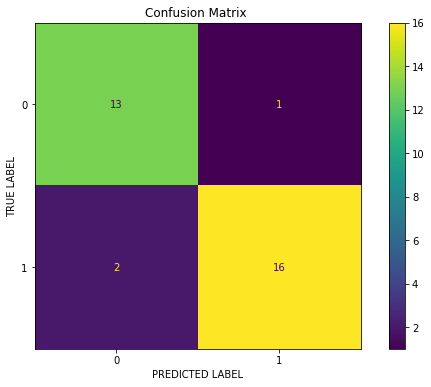

In [297]:
print_metrics(y_test, y_pred_nb)
print('\n')
function_confusion_matrix(model_naive_bayes,X_test,y_test)

###Naive Bayes - Hyperparameters

In [298]:
%%time
model_naive_bayes_hyper = GaussianNB(var_smoothing = 0.0000001)
model_naive_bayes_hyper.fit(X_train, y_train)

CPU times: user 3.56 ms, sys: 0 ns, total: 3.56 ms
Wall time: 6.14 ms


In [299]:
y_pred_nb_hyper = model_naive_bayes_hyper.predict(X_test)

[[13  1]
 [ 2 16]]
              precision    recall  f1-score   support

           0       0.87      0.93      0.90        14
           1       0.94      0.89      0.91        18

    accuracy                           0.91        32
   macro avg       0.90      0.91      0.91        32
weighted avg       0.91      0.91      0.91        32

0.90625




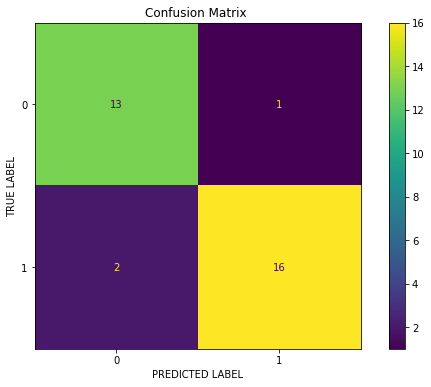

In [300]:
print_metrics(y_test, y_pred_nb_hyper)
print('\n')
function_confusion_matrix(model_naive_bayes_hyper,X_test,y_test)

## Decision Tree

In [301]:
from sklearn.tree import DecisionTreeClassifier

In [302]:
%%time
model_decision_tree = DecisionTreeClassifier()
model_decision_tree = model_decision_tree.fit(X_train,y_train)

CPU times: user 3.28 ms, sys: 22 µs, total: 3.31 ms
Wall time: 5.04 ms


In [303]:
y_pred_decision_tree = model_decision_tree.predict(X_test)

[[12  2]
 [ 3 15]]
              precision    recall  f1-score   support

           0       0.80      0.86      0.83        14
           1       0.88      0.83      0.86        18

    accuracy                           0.84        32
   macro avg       0.84      0.85      0.84        32
weighted avg       0.85      0.84      0.84        32

0.84375




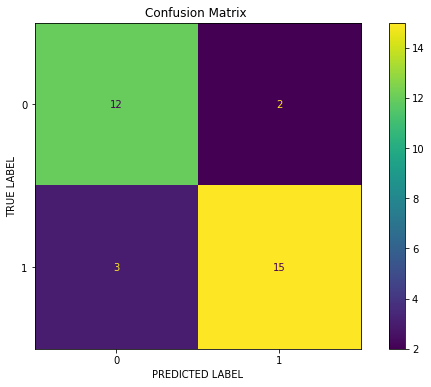

In [304]:
print_metrics(y_test,y_pred_decision_tree)
print('\n')
function_confusion_matrix(model_decision_tree,X_test,y_test)

###Decision Tree - Hyperparameter

In [305]:
%%time
model_decision_tree_hyper = DecisionTreeClassifier(criterion = "entropy", splitter = "random",max_depth = 10)
model_decision_tree_hyper = model_decision_tree_hyper.fit(X_train,y_train)

CPU times: user 1.59 ms, sys: 994 µs, total: 2.58 ms
Wall time: 4.3 ms


In [306]:
y_pred_decision_tree = model_decision_tree.predict(X_test)

[[12  2]
 [ 3 15]]
              precision    recall  f1-score   support

           0       0.80      0.86      0.83        14
           1       0.88      0.83      0.86        18

    accuracy                           0.84        32
   macro avg       0.84      0.85      0.84        32
weighted avg       0.85      0.84      0.84        32

0.84375




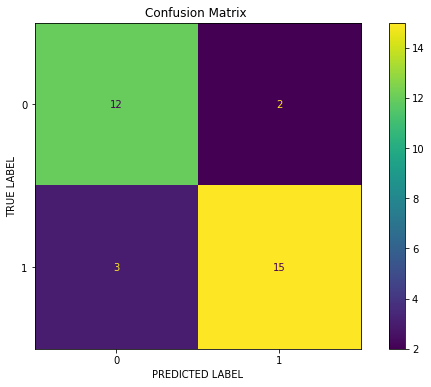

In [307]:
print_metrics(y_test,y_pred_decision_tree)
print('\n')
function_confusion_matrix(model_decision_tree,X_test,y_test)

In [308]:
%%time
model_decision_tree_hyper = DecisionTreeClassifier(splitter = "random",max_depth = 10)
model_decision_tree_hyper = model_decision_tree_hyper.fit(X_train,y_train)

CPU times: user 1.56 ms, sys: 0 ns, total: 1.56 ms
Wall time: 1.57 ms


In [309]:
y_pred_decision_tree_hyper = model_decision_tree_hyper.predict(X_test)

[[12  2]
 [ 4 14]]
              precision    recall  f1-score   support

           0       0.75      0.86      0.80        14
           1       0.88      0.78      0.82        18

    accuracy                           0.81        32
   macro avg       0.81      0.82      0.81        32
weighted avg       0.82      0.81      0.81        32

0.8125




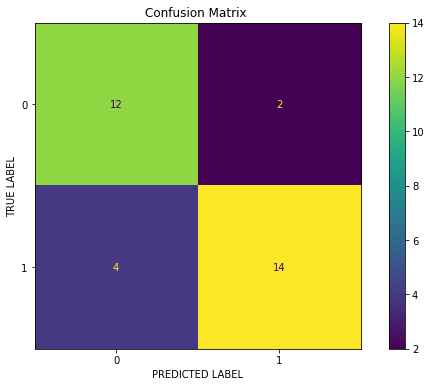

In [310]:
print_metrics(y_test,y_pred_decision_tree_hyper)
print('\n')
function_confusion_matrix(model_decision_tree_hyper,X_test,y_test)

In [311]:
%%time
model_decision_tree_hyper2 = DecisionTreeClassifier(max_depth = 100)
model_decision_tree_hyper2 = model_decision_tree_hyper2.fit(X_train,y_train)

CPU times: user 1.9 ms, sys: 1.02 ms, total: 2.91 ms
Wall time: 2.31 ms


In [312]:
y_pred_decision_tree_hyper2 = model_decision_tree_hyper2.predict(X_test)

[[12  2]
 [ 4 14]]
              precision    recall  f1-score   support

           0       0.75      0.86      0.80        14
           1       0.88      0.78      0.82        18

    accuracy                           0.81        32
   macro avg       0.81      0.82      0.81        32
weighted avg       0.82      0.81      0.81        32

0.8125




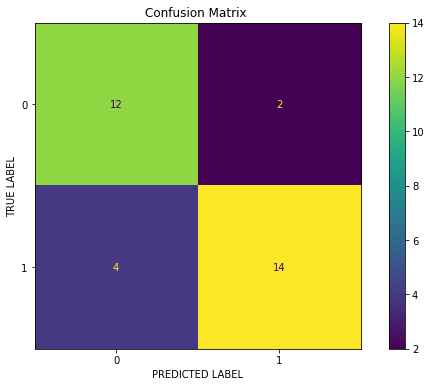

In [313]:
print_metrics(y_test,y_pred_decision_tree_hyper2)
print('\n')
function_confusion_matrix(model_decision_tree_hyper2,X_test,y_test)

## Random Forest

In [314]:
from sklearn.ensemble import RandomForestClassifier

In [315]:
rf = RandomForestClassifier(n_estimators=500)
rf = rf.fit(X_train,y_train)

In [316]:
y_pred_rf = rf.predict(X_test)

[[13  1]
 [ 2 16]]
              precision    recall  f1-score   support

           0       0.87      0.93      0.90        14
           1       0.94      0.89      0.91        18

    accuracy                           0.91        32
   macro avg       0.90      0.91      0.91        32
weighted avg       0.91      0.91      0.91        32

0.90625




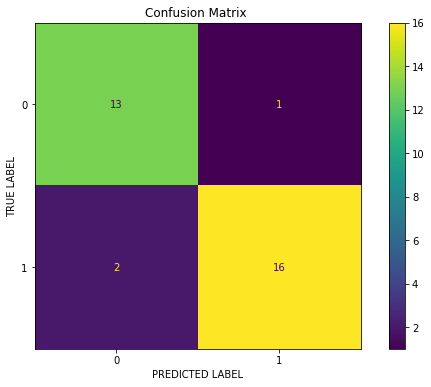

In [317]:
print_metrics(y_test,y_pred_rf)
print('\n')
function_confusion_matrix(rf,X_test,y_test)

##Linear SVM

In [318]:
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn import svm

In [319]:
%%time
model_linear_svm = svm.SVC(kernel='linear')
model_linear_svm.fit(X_train, y_train)

CPU times: user 2.79 ms, sys: 0 ns, total: 2.79 ms
Wall time: 3.06 ms


In [320]:
y_pred_linear_svm = model_linear_svm.predict(X_test)

[[13  1]
 [ 2 16]]
              precision    recall  f1-score   support

           0       0.87      0.93      0.90        14
           1       0.94      0.89      0.91        18

    accuracy                           0.91        32
   macro avg       0.90      0.91      0.91        32
weighted avg       0.91      0.91      0.91        32

0.90625




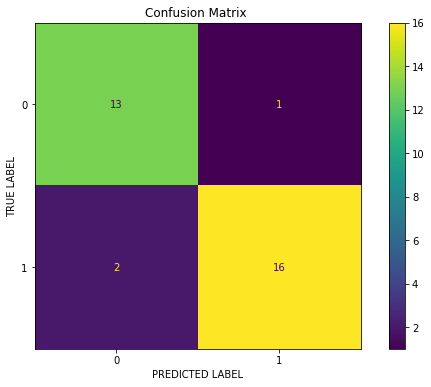

In [321]:
print_metrics(y_test,y_pred_linear_svm)
print('\n')
function_confusion_matrix(model_linear_svm,X_test,y_test)

##Linear SVM - Hyperparameters

In [322]:
%%time
model_linear_svm_hyper1 = svm.SVC(gamma='auto')
model_linear_svm_hyper1.fit(X_train, y_train)

CPU times: user 2.79 ms, sys: 0 ns, total: 2.79 ms
Wall time: 2.73 ms


In [323]:
y_pred_linear_svm_hyper1 = model_linear_svm_hyper1.predict(X_test)

[[ 8  6]
 [ 2 16]]
              precision    recall  f1-score   support

           0       0.80      0.57      0.67        14
           1       0.73      0.89      0.80        18

    accuracy                           0.75        32
   macro avg       0.76      0.73      0.73        32
weighted avg       0.76      0.75      0.74        32

0.75




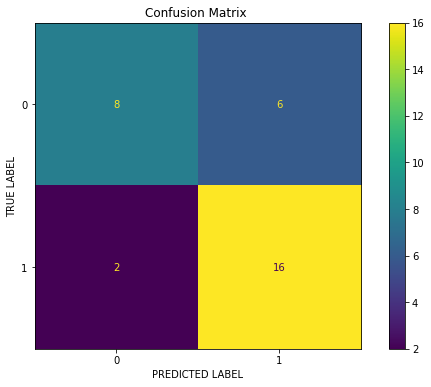

In [324]:
print_metrics(y_test,y_pred_linear_svm_hyper1)
print('\n')
function_confusion_matrix(model_linear_svm_hyper1,X_test,y_test)

In [325]:
%%time
model_linear_svm_hyper2 = svm.SVC(gamma='auto',decision_function_shape='ovo',tol=0.0001)
model_linear_svm_hyper2.fit(X_train, y_train)

CPU times: user 2.24 ms, sys: 954 µs, total: 3.19 ms
Wall time: 2.5 ms


In [326]:
y_pred_linear_svm_hyper2 = model_linear_svm_hyper2.predict(X_test)

[[ 8  6]
 [ 2 16]]
              precision    recall  f1-score   support

           0       0.80      0.57      0.67        14
           1       0.73      0.89      0.80        18

    accuracy                           0.75        32
   macro avg       0.76      0.73      0.73        32
weighted avg       0.76      0.75      0.74        32

0.75




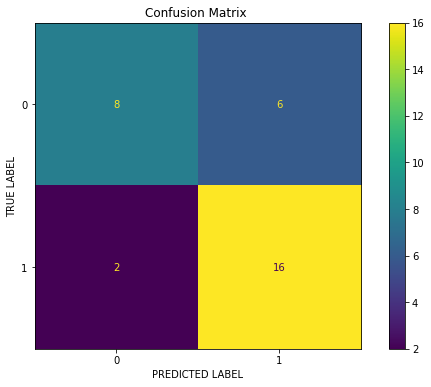

In [327]:
print_metrics(y_test,y_pred_linear_svm_hyper2)
print('\n')
function_confusion_matrix(model_linear_svm_hyper2,X_test,y_test)

##Logistic Regression

In [328]:
from sklearn.linear_model import LogisticRegression

In [329]:
%%time
model_logistic_regression = LogisticRegression(random_state=42)
model_logistic_regression = model_logistic_regression.fit(X_train, y_train)

CPU times: user 17.7 ms, sys: 873 µs, total: 18.6 ms
Wall time: 19.1 ms


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


In [330]:
y_pred_logistic_regression = model_logistic_regression.predict(X_test)

[[12  2]
 [ 2 16]]
              precision    recall  f1-score   support

           0       0.86      0.86      0.86        14
           1       0.89      0.89      0.89        18

    accuracy                           0.88        32
   macro avg       0.87      0.87      0.87        32
weighted avg       0.88      0.88      0.88        32

0.875




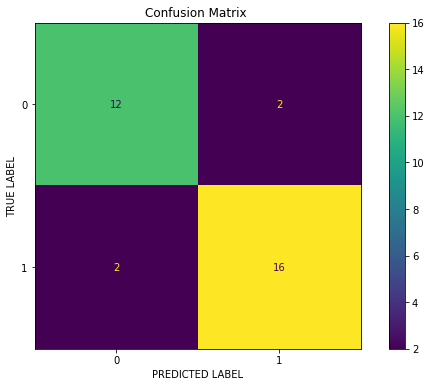

In [331]:
print_metrics(y_test, y_pred_logistic_regression)
print('\n')
function_confusion_matrix(model_logistic_regression, X_test, y_test)

##Logistic Regression - Hyperparameters

In [332]:
%%time
model_logistic_regression_hyper1 = LogisticRegression(random_state=42, solver='liblinear')
model_logistic_regression_hyper1 = model_logistic_regression_hyper1.fit(X_train, y_train)

CPU times: user 1.88 ms, sys: 1.01 ms, total: 2.89 ms
Wall time: 2.37 ms


In [333]:
y_pred_logistic_regression_hyper1 = model_logistic_regression_hyper1.predict(X_test)

[[ 8  6]
 [ 1 17]]
              precision    recall  f1-score   support

           0       0.89      0.57      0.70        14
           1       0.74      0.94      0.83        18

    accuracy                           0.78        32
   macro avg       0.81      0.76      0.76        32
weighted avg       0.80      0.78      0.77        32

0.78125




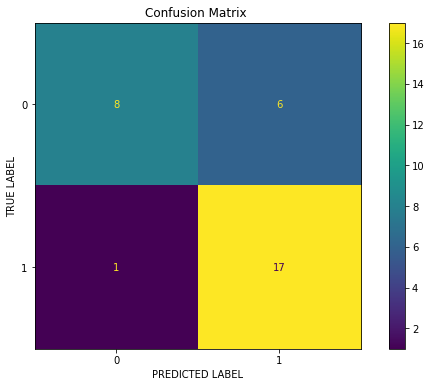

In [334]:
print_metrics(y_test, y_pred_logistic_regression_hyper1)
print('\n')
function_confusion_matrix(model_logistic_regression_hyper1, X_test, y_test)

In [335]:
%%time
model_logistic_regression_hyper2 = LogisticRegression(random_state=42, solver='newton-cg')
model_logistic_regression_hyper2 = model_logistic_regression_hyper2.fit(X_train, y_train)

CPU times: user 20.8 ms, sys: 9.54 ms, total: 30.4 ms
Wall time: 24.3 ms


In [336]:
y_pred_logistic_regression_hyper2 = model_logistic_regression_hyper2.predict(X_test)

[[12  2]
 [ 2 16]]
              precision    recall  f1-score   support

           0       0.86      0.86      0.86        14
           1       0.89      0.89      0.89        18

    accuracy                           0.88        32
   macro avg       0.87      0.87      0.87        32
weighted avg       0.88      0.88      0.88        32

0.875




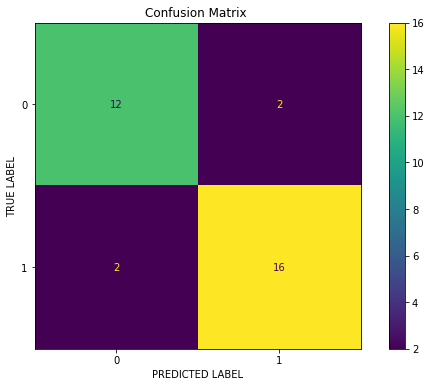

In [337]:
print_metrics(y_test, y_pred_logistic_regression_hyper2)
print('\n')
function_confusion_matrix(model_logistic_regression_hyper2, X_test, y_test)

##Multlayer Perceptron

In [338]:
from sklearn.neural_network import MLPClassifier

In [339]:
%%time
model_perceptron = MLPClassifier(random_state=1, max_iter=1000)
model_perceptron = model_perceptron.fit(X_train, y_train)

CPU times: user 200 ms, sys: 173 ms, total: 373 ms
Wall time: 248 ms


In [340]:
y_pred_perceptron = model_perceptron.predict(X_test)

[[ 7  7]
 [ 1 17]]
              precision    recall  f1-score   support

           0       0.88      0.50      0.64        14
           1       0.71      0.94      0.81        18

    accuracy                           0.75        32
   macro avg       0.79      0.72      0.72        32
weighted avg       0.78      0.75      0.73        32

0.75




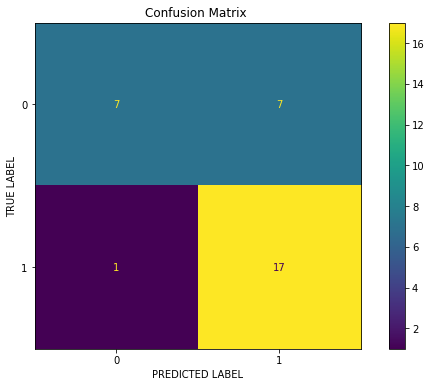

In [341]:
print_metrics(y_test, y_pred_perceptron)
print('\n')
function_confusion_matrix(model_perceptron, X_test, y_test)

##MLPClassifier - Hyperparameter

In [342]:
%%time
model_perceptron_hyper = MLPClassifier(random_state=1, hidden_layer_sizes=(200,200))
model_perceptron_hyper = model_perceptron_hyper.fit(X_train, y_train)

CPU times: user 416 ms, sys: 316 ms, total: 731 ms
Wall time: 390 ms


In [343]:
y_pred_perceptron_hyper = model_perceptron_hyper.predict(X_test)

[[ 7  7]
 [ 3 15]]
              precision    recall  f1-score   support

           0       0.70      0.50      0.58        14
           1       0.68      0.83      0.75        18

    accuracy                           0.69        32
   macro avg       0.69      0.67      0.67        32
weighted avg       0.69      0.69      0.68        32

0.6875




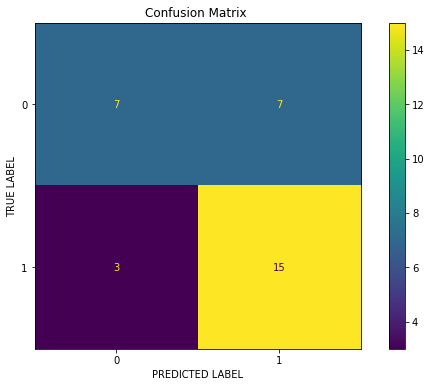

In [344]:
print_metrics(y_test, y_pred_perceptron_hyper)
print('\n')
function_confusion_matrix(model_perceptron_hyper, X_test, y_test)

In [182]:
import pickle

In [354]:
with open('naive_bayes.pk', 'wb') as files:
    pickle.dump(model_naive_bayes, files)

In [359]:
columns = data_select2.columns
voc = {}
for i in range(len(columns)):
  voc[columns[i]] = i

In [366]:
print(voc)
print(text_bow.vocabulary_)

{'abaixochina': 0, 'aceitacao': 1, 'acionado': 2, 'alto': 3, 'amei': 4, 'amoled': 5, 'armazenamento': 6, 'assemblymontagem': 7, 'atftimer': 8, 'bdbb': 9, 'bddc': 10, 'bindevents': 11, 'bluetooth': 12, 'bold': 13, 'calc': 14, 'camera': 15, 'catalao': 16, 'characters': 17, 'clientwidth': 18, 'companyabilitytags': 19, 'conector': 20, 'createelement': 21, 'cursor': 22, 'desbloqueio': 23, 'energia': 24, 'entrega': 25, 'expand': 26, 'fdd': 27, 'fmtrii': 28, 'footer': 29, 'gratis': 30, 'imageid': 31, 'initcomplete': 32, 'isblackfriday': 33, 'jurosreceba': 34, 'letao': 35, 'lituano': 36, 'memory': 37, 'mera': 38, 'metro': 39, 'midia': 40, 'mostrador': 41, 'multilaser': 42, 'nfc': 43, 'notas': 44, 'notificacoes': 45, 'offerstockavailable': 46, 'padrao': 47, 'pais': 48, 'pessoa': 49, 'pixels': 50, 'polones': 51, 'preimg': 52, 'radius': 53, 'sale': 54, 'smartphone': 55, 'smartphones': 56, 'touch': 57, 'utilizando': 58, 'value': 59, 'version': 60, 'vestivel': 61, 'virtude': 62, 'wcdma': 63, 'zelan

In [364]:
with open('vocabulary.pk', 'wb') as files:
    pickle.dump(voc, files)